In [1]:
from tqdm import tqdm, trange
from IPython.display import HTML

import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation

import torch
import torch.nn as nn
from torch.utils.data import DataLoader
import torch.nn.parallel
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils

from torch import Tensor

In [2]:
cifar_data = dset.CIFAR10(
    root='../../datasets',
    download=False,
    train=True,
    transform=transforms.Compose([
        transforms.ToTensor()
    ])
)

dataloader = DataLoader(cifar_data, batch_size=256, shuffle=True)

In [3]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

In [4]:
device

device(type='cuda', index=0)

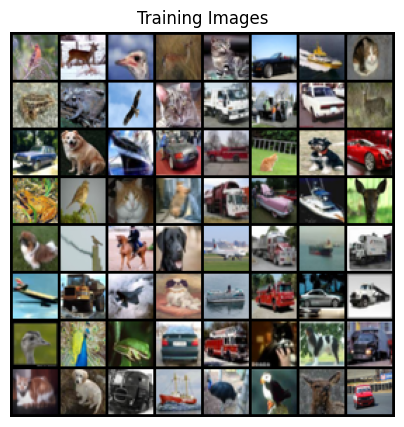

In [5]:
real_batch = next(iter(dataloader))
plt.figure(figsize=(5,5))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))
plt.show()

In [6]:
class Generator(nn.Module):
    def __init__(self, latent_dim=100, n_channels=1, img_s=28):
        super().__init__()
        self.generator = nn.Sequential(
            nn.ConvTranspose2d(latent_dim, img_s * 8, kernel_size=4, stride=1, padding=0, bias=False),
            nn.BatchNorm2d(img_s * 8),
            nn.ReLU(inplace=True),
            
            nn.ConvTranspose2d(img_s * 8, img_s * 4, kernel_size=4, stride=2, padding=0, bias=False),
            nn.BatchNorm2d(img_s * 4),
            nn.ReLU(inplace=True),

            nn.ConvTranspose2d(img_s * 4, img_s * 2, kernel_size=4, stride=2, padding=2, bias=False),
            nn.BatchNorm2d(img_s * 2),
            nn.ReLU(inplace=True),

            nn.ConvTranspose2d(img_s * 2, n_channels, kernel_size=2, stride=2, padding=2),
            nn.Tanh()
        )

    def forward(self, z: Tensor):
        return self.generator(z)

In [7]:
class Discriminator(nn.Module):
    def __init__(self, n_channels=1, img_s=28):
        super().__init__()
        self.discriminator = nn.Sequential(
            nn.Conv2d(n_channels, img_s * 2, kernel_size=4, stride=2, padding=1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            
            nn.Conv2d(img_s * 2, img_s * 4, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(img_s * 4),
            nn.LeakyReLU(0.2, inplace=True),
            
            nn.Conv2d(img_s * 4, img_s * 8, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(img_s * 8),
            nn.LeakyReLU(0.2, inplace=True),
            
            nn.Conv2d(img_s * 8, 1, kernel_size=4, stride=1, padding=0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, x: Tensor):
        return self.discriminator(x)

In [8]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'

n_channels = 3
img_s = 32
latent_dim = 100
batch_size = 256


lr = 0.0002
epochs = 300
beta1, beta2 = (0.5, 0.999)
real_label = 1
fake_label = 0
iters = 0

fixed_noise = torch.randn(64, latent_dim, 1, 1, device=device)

In [9]:
generator = Generator(latent_dim, n_channels, img_s).to(device)
discriminator = Discriminator(n_channels, img_s).to(device)

loss_fn = nn.BCELoss()

optimizerG = optim.Adam(generator.parameters(), lr=lr, betas=(beta1, beta2))
optimizerD = optim.Adam(discriminator.parameters(), lr=lr, betas=(beta1, beta2))

In [10]:
G_errors = []
D_errors = []
img_list = []

for epoch in tqdm(pbar := trange(epochs)):
    for i, (x, _) in enumerate(dataloader):
        x: Tensor = x.to(device)
        x_batch = x.shape[0]
        # Train discriminator
        # Train with real data
        discriminator.zero_grad()
        labels = torch.full((x_batch, ), fill_value=real_label, dtype=torch.float, device=device)
        labels = labels.view(-1, 1)  # Reshape labels to match the shape of D_output
        D_output = discriminator(x).view(-1, 1)
        D_error_real = loss_fn(D_output, labels)
        D_error_real.backward()

        # Train with fake data
        z = torch.randn(x_batch, latent_dim, 1, 1, device=device)
        x_bar = generator(z)
        labels.fill_(fake_label)
        D_output = discriminator(x_bar).view(-1, 1) # Reshape D_output to match labels
        D_error_fake = loss_fn(D_output, labels)
        D_error_fake.backward(retain_graph=True)

        D_error: Tensor = D_error_real + D_error_fake
        optimizerD.step()

        # Train generator
        generator.zero_grad()
        labels.fill_(real_label)
        D_output = discriminator(x_bar).view(-1, 1)
        G_error: Tensor = loss_fn(D_output, labels)
        G_error.backward()
        optimizerG.step()

        if (iters % 500 == 0) or ((epoch == epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = generator(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1

    pbar.set_description(f'Epoch [{epoch+1}/{epochs}] Loss D: {D_error.item()} Loss G: {G_error.item()}')
    D_errors.append(D_error)
    G_errors.append(G_error)

Epoch [300/300] Loss D: 0.0750945508480072 Loss G: 4.950734615325928: 100%|██████████| 300/300 [1:19:10<00:00, 15.83s/it]   
100%|██████████| 300/300 [1:19:10<00:00, 15.83s/it]


In [11]:
torch.save(generator.state_dict(), ".\\generator.pth")
torch.save(discriminator.state_dict(), ".\\discriminator.pth")

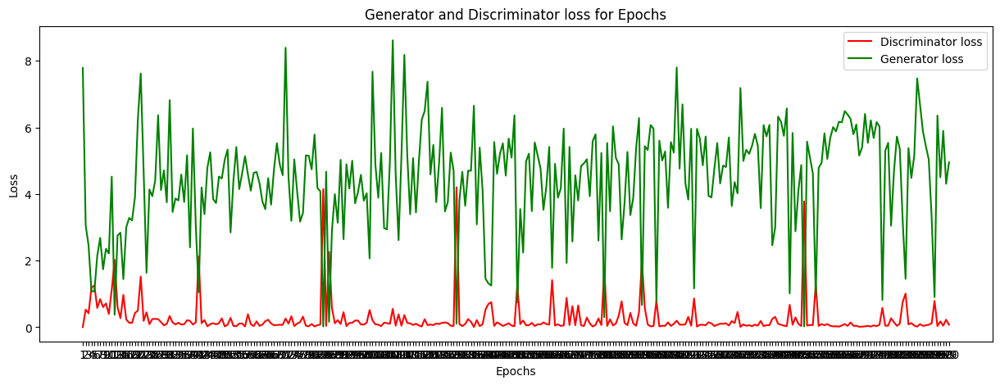

In [53]:
D_errors_np = np.array([err.item() for err in D_errors])
G_errors_np = np.array([err.item() for err in G_errors])
x_epochs = range(1,epochs+1)

plt.figure(figsize=(15, 5))
plt.plot(x_epochs, D_errors_np, label='Discriminator loss', color='red')
plt.plot(x_epochs, G_errors_np, label='Generator loss', color='green')
plt.title('Generator and Discriminator loss for Epochs')
plt.ylabel('Loss')
plt.xlabel('Epochs')
plt.xticks(x_epochs)
plt.legend()
plt.show()

### As can be seen results are not noisy or not visibile, however, better architectures and more epochs can help the model to generate better images

Animation size has reached 21569488 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


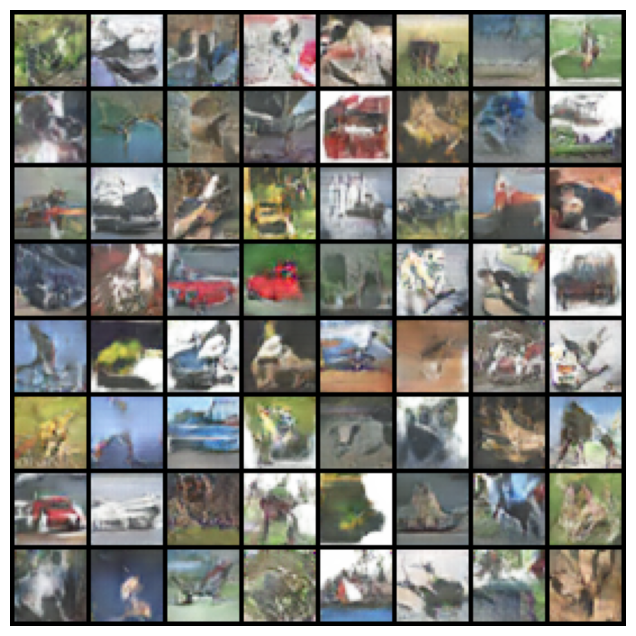

In [13]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())